In [ ]:
import os
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision.transforms as T
import torch.optim as optim

In [ ]:
class DehazingDataset(Dataset):
    def __init__(self, hazy_dir, clear_dir, transform=None):
        self.hazy_images = sorted(os.listdir(hazy_dir))
        self.clear_images = sorted(os.listdir(clear_dir))
        self.hazy_dir = hazy_dir
        self.clear_dir = clear_dir
        self.transform = transform

    def __len__(self):
        return len(self.hazy_images)

    def __getitem__(self, idx):
        hazy_path = os.path.join(self.hazy_dir, self.hazy_images[idx])
        clear_path = os.path.join(self.clear_dir, self.clear_images[idx])

        hazy = Image.open(hazy_path).convert('RGB')
        clear = Image.open(clear_path).convert('RGB')

        if self.transform:
            hazy = self.transform(hazy)
            clear = self.transform(clear)

        return hazy, clear

# Example transforms
transform = T.Compose([
    T.Resize((256, 256)),
    T.ToTensor(),
    T.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

# Initialize dataset and dataloader
train_dataset = DehazingDataset('/kaggle/input/images/hazy', '/kaggle/input/images/GT', transform=transform)
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)

NameError: name 'Dataset' is not defined

**defining NafNet**

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim


class LayerNorm2d(nn.Module):
    def __init__(self, num_channels, eps=1e-5):
        super().__init__()
        self.weight = nn.Parameter(torch.ones(1, num_channels, 1, 1))
        self.bias = nn.Parameter(torch.zeros(1, num_channels, 1, 1))
        self.eps = eps

    def forward(self, x):
        mean = x.mean(dim=(2, 3), keepdim=True)
        var = x.var(dim=(2, 3), keepdim=True, unbiased=False)
        return (x - mean) / (var + self.eps).sqrt() * self.weight + self.bias


class SimpleGate(nn.Module):
    def forward(self, x):
        x1, x2 = x.chunk(2, dim=1)
        return x1 * x2


class NAFBlock(nn.Module):
    def __init__(self, c, DW_Expand=2, FFN_Expand=2, drop_out_rate=0.):
        super().__init__()
        dw_channel = c * DW_Expand
        self.conv1 = nn.Conv2d(in_channels=c, out_channels=dw_channel, kernel_size=1, stride=1, bias=True)
        self.conv2 = nn.Conv2d(in_channels=dw_channel, out_channels=dw_channel, kernel_size=3, stride=1, padding=1, groups=dw_channel, bias=True)
        self.conv3 = nn.Conv2d(in_channels=dw_channel // 2, out_channels=c, kernel_size=1, stride=1, bias=True)

        self.sca = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels=dw_channel // 2, out_channels=dw_channel // 2, kernel_size=1, stride=1, bias=True),
        )

        self.sg = SimpleGate()

        ffn_channel = FFN_Expand * c
        self.conv4 = nn.Conv2d(in_channels=c, out_channels=ffn_channel, kernel_size=1, stride=1, bias=True)
        self.conv5 = nn.Conv2d(in_channels=ffn_channel // 2, out_channels=c, kernel_size=1, stride=1, bias=True)

        self.norm1 = LayerNorm2d(c)
        self.norm2 = LayerNorm2d(c)

        self.dropout1 = nn.Dropout(drop_out_rate) if drop_out_rate > 0. else nn.Identity()
        self.dropout2 = nn.Dropout(drop_out_rate) if drop_out_rate > 0. else nn.Identity()

        self.beta = nn.Parameter(torch.zeros((1, c, 1, 1)), requires_grad=True)
        self.gamma = nn.Parameter(torch.zeros((1, c, 1, 1)), requires_grad=True)

    def forward(self, inp):
        x = self.norm1(inp)

        x = self.conv1(x)
        x = self.conv2(x)
        x = self.sg(x)
        x = x * self.sca(x)
        x = self.conv3(x)
        x = self.dropout1(x)

        y = inp + x * self.beta

        x = self.conv4(self.norm2(y))
        x = self.sg(x)
        x = self.conv5(x)
        x = self.dropout2(x)

        return y + x * self.gamma

class NAFNet(nn.Module):
    def __init__(self, img_channel=3, width=16, middle_blk_num=1, enc_blk_nums=[], dec_blk_nums=[]):
        super().__init__()

        self.intro = nn.Conv2d(in_channels=img_channel, out_channels=width, kernel_size=3, stride=1, padding=1, bias=True)
        self.ending = nn.Conv2d(in_channels=width, out_channels=img_channel, kernel_size=3, stride=1, padding=1, bias=True)

        self.encoders = nn.ModuleList()
        self.decoders = nn.ModuleList()
        self.middle_blks = nn.ModuleList()
        self.ups = nn.ModuleList()
        self.downs = nn.ModuleList()

        chan = width
        for num in enc_blk_nums:
            self.encoders.append(nn.Sequential(*[NAFBlock(chan) for _ in range(num)]))
            self.downs.append(nn.Conv2d(chan, chan * 2, kernel_size=2, stride=2))
            chan *= 2
    #
        self.middle_blks = nn.Sequential(*[NAFBlock(chan) for _ in range(middle_blk_num)])

        for num in dec_blk_nums:
            self.ups.append(nn.Sequential(nn.Conv2d(chan, chan * 2, kernel_size=1, bias=False), nn.PixelShuffle(2)))
            chan //= 2
            self.decoders.append(nn.Sequential(*[NAFBlock(chan) for _ in range(num)]))

        self.padder_size = 2 ** len(self.encoders)

    def forward(self, inp):
        B, C, H, W = inp.shape
        inp = self.check_image_size(inp)

        x = self.intro(inp)
        encs = []

        for encoder, down in zip(self.encoders, self.downs):
            x = encoder(x)
            encs.append(x)
            x = down(x)

        x = self.middle_blks(x)
     #
        for decoder, up, enc_skip in zip(self.decoders, self.ups, encs[::-1]):
            x = up(x)
            x = x + enc_skip
            x = decoder(x)

        x = self.ending(x)
        x = x + inp

        return x[:, :, :H, :W]

    def check_image_size(self, x):
        _, _, h, w = x.size()
        pad_h = (self.padder_size - h % self.padder_size) % self.padder_size
        pad_w = (self.padder_size - w % self.padder_size) % self.padder_size
        x = F.pad(x, (0, pad_w, 0, pad_h))
        return x

class NAFNetLocal(NAFNet):
    def __init__(self, *args, train_size=(1, 3, 256, 256), fast_imp=False, **kwargs):
        super().__init__(*args, **kwargs)

        N, C, H, W = train_size
        base_size = (int(H * 1.5), int(W * 1.5))

        self.eval()
        with torch.no_grad():
            self.convert(base_size=base_size, train_size=train_size, fast_imp=fast_imp)

In [ ]:
!pip install ptflops
from ptflops import get_model_complexity_info
print("ptflops installed successfully!")

ptflops installed successfully!


In [ ]:
import torch.nn.functional as F
if __name__ == '__main__':
    img_channel = 3
    width = 32

    enc_blks = [1, 1, 1, 28]
    middle_blk_num = 1
    dec_blks = [1, 1, 1, 1]

    net = NAFNet(img_channel=img_channel, width=width, middle_blk_num=middle_blk_num, enc_blk_nums=enc_blks, dec_blk_nums=dec_blks)

    inp_shape = (3, 256, 256)

    from ptflops import get_model_complexity_info

    macs, params = get_model_complexity_info(net, inp_shape, verbose=False, print_per_layer_stat=False)

    print(f"MACs: {macs} | Params: {params}")

MACs: 16.11 GMac | Params: 17.11 M


Dehazing Process

In [ ]:
import torch.nn.functional as F

def ssim_loss(pred, target):
    """Compute Structural Similarity (SSIM) Loss."""
    mu_x = F.avg_pool2d(pred, kernel_size=3, stride=1, padding=1)
    mu_y = F.avg_pool2d(target, kernel_size=3, stride=1, padding=1)
    sigma_x = F.avg_pool2d(pred ** 2, kernel_size=3, stride=1, padding=1) - mu_x ** 2
    sigma_y = F.avg_pool2d(target ** 2, kernel_size=3, stride=1, padding=1) - mu_y ** 2
    sigma_xy = F.avg_pool2d(pred * target, kernel_size=3, stride=1, padding=1) - mu_x * mu_y

    C1 = 0.01 ** 2
    C2 = 0.03 ** 2

    ssim_map = ((2 * mu_x * mu_y + C1) * (2 * sigma_xy + C2)) / \
               ((mu_x ** 2 + mu_y ** 2 + C1) * (sigma_x + sigma_y + C2))
    return 1 - ssim_map.mean()
#
def combined_loss(pred, target):
    """Combine MSE Loss and SSIM Loss."""
    mse_loss = F.mse_loss(pred, target)
    return mse_loss + 0.1 * ssim_loss(pred, target)


/tmp/ipykernel_23/2066976380.py:102: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()  # Mixed precision scaler
/tmp/ipykernel_23/2066976380.py:118: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Enable mixed precision


Epoch 1, Loss: 0.3805
Epoch 2, Loss: 0.2900
Epoch 3, Loss: 0.2758
Epoch 4, Loss: 0.2536
Epoch 5, Loss: 0.2524
Epoch 6, Loss: 0.2520
Epoch 7, Loss: 0.2433
Epoch 8, Loss: 0.2436
Epoch 9, Loss: 0.2393
Epoch 10, Loss: 0.2400
Epoch 11, Loss: 0.2307
Epoch 12, Loss: 0.2439
Epoch 13, Loss: 0.2372
Epoch 14, Loss: 0.2219
Epoch 15, Loss: 0.2220
Epoch 16, Loss: 0.2219
Epoch 17, Loss: 0.2317
Epoch 18, Loss: 0.2237
Epoch 19, Loss: 0.2138
Epoch 20, Loss: 0.2159
Epoch 21, Loss: 0.2133
Epoch 22, Loss: 0.2061
Epoch 23, Loss: 0.2051
Epoch 24, Loss: 0.2054
Epoch 25, Loss: 0.1979
Epoch 26, Loss: 0.1953
Epoch 27, Loss: 0.2015
Epoch 28, Loss: 0.1906
Epoch 29, Loss: 0.1876
Epoch 30, Loss: 0.1895
Epoch 31, Loss: 0.1852
Epoch 32, Loss: 0.1853
Epoch 33, Loss: 0.1841
Epoch 34, Loss: 0.1890
Epoch 35, Loss: 0.1963
Epoch 36, Loss: 0.1883
Epoch 37, Loss: 0.1857
Epoch 38, Loss: 0.1820
Epoch 39, Loss: 0.1807
Epoch 40, Loss: 0.1765
Epoch 41, Loss: 0.1730
Epoch 42, Loss: 0.1723
Epoch 43, Loss: 0.1727
Epoch 44, Loss: 0.18

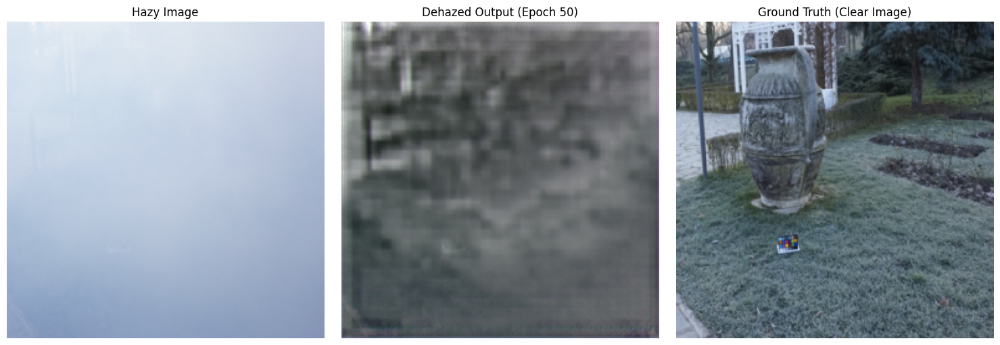

Epoch 51, Loss: 0.1599
Epoch 52, Loss: 0.1612
Epoch 53, Loss: 0.1596
Epoch 54, Loss: 0.1570
Epoch 55, Loss: 0.1494
Epoch 56, Loss: 0.1476
Epoch 57, Loss: 0.1473
Epoch 58, Loss: 0.1452
Epoch 59, Loss: 0.1440
Epoch 60, Loss: 0.1415
Epoch 61, Loss: 0.1463
Epoch 62, Loss: 0.1466
Epoch 63, Loss: 0.1432
Epoch 64, Loss: 0.1437
Epoch 65, Loss: 0.1399
Epoch 66, Loss: 0.1397
Epoch 67, Loss: 0.1366
Epoch 68, Loss: 0.1399
Epoch 69, Loss: 0.1372
Epoch 70, Loss: 0.1360
Epoch 71, Loss: 0.1335
Epoch 72, Loss: 0.1284
Epoch 73, Loss: 0.1336
Epoch 74, Loss: 0.1321
Epoch 75, Loss: 0.1336
Epoch 76, Loss: 0.1366
Epoch 77, Loss: 0.1351
Epoch 78, Loss: 0.1307
Epoch 79, Loss: 0.1361
Epoch 80, Loss: 0.1372
Epoch 81, Loss: 0.1383
Epoch 82, Loss: 0.1390
Epoch 83, Loss: 0.1333
Epoch 84, Loss: 0.1310
Epoch 85, Loss: 0.1259
Epoch 86, Loss: 0.1274
Epoch 87, Loss: 0.1304
Epoch 88, Loss: 0.1256
Epoch 89, Loss: 0.1241
Epoch 90, Loss: 0.1221
Epoch 91, Loss: 0.1189
Epoch 92, Loss: 0.1165
Epoch 93, Loss: 0.1185
Epoch 94, L

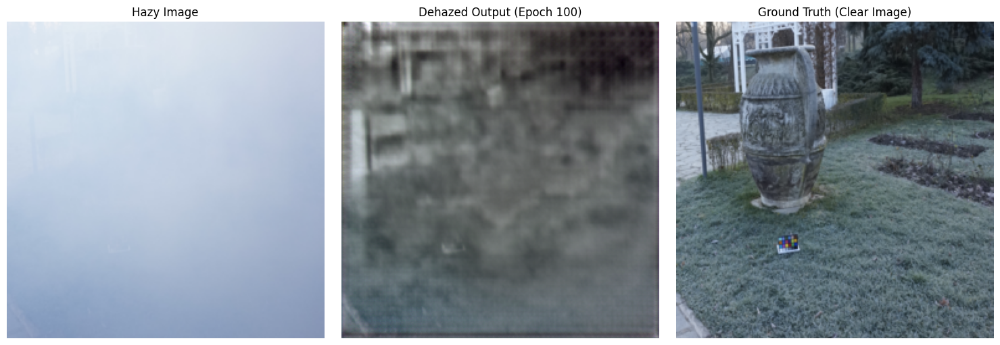

Epoch 101, Loss: 0.1077
Epoch 102, Loss: 0.1081
Epoch 103, Loss: 0.1103
Epoch 104, Loss: 0.1074
Epoch 105, Loss: 0.1108
Epoch 106, Loss: 0.1179
Epoch 107, Loss: 0.1133
Epoch 108, Loss: 0.1166
Epoch 109, Loss: 0.1201
Epoch 110, Loss: 0.1227
Epoch 111, Loss: 0.1229
Epoch 112, Loss: 0.1209
Epoch 113, Loss: 0.1149
Epoch 114, Loss: 0.1166
Epoch 115, Loss: 0.1126
Epoch 116, Loss: 0.1086
Epoch 117, Loss: 0.1086
Epoch 118, Loss: 0.1102
Epoch 119, Loss: 0.1042
Epoch 120, Loss: 0.1051
Epoch 121, Loss: 0.1034
Epoch 122, Loss: 0.1030
Epoch 123, Loss: 0.1032
Epoch 124, Loss: 0.1019
Epoch 125, Loss: 0.1017
Epoch 126, Loss: 0.1002
Epoch 127, Loss: 0.1026
Epoch 128, Loss: 0.1030
Epoch 129, Loss: 0.1066
Epoch 130, Loss: 0.1076
Epoch 131, Loss: 0.1071
Epoch 132, Loss: 0.1058
Epoch 133, Loss: 0.1007
Epoch 134, Loss: 0.0985
Epoch 135, Loss: 0.1029
Epoch 136, Loss: 0.1013
Epoch 137, Loss: 0.0983
Epoch 138, Loss: 0.0992
Epoch 139, Loss: 0.1003
Epoch 140, Loss: 0.0988
Epoch 141, Loss: 0.1003
Epoch 142, Loss:

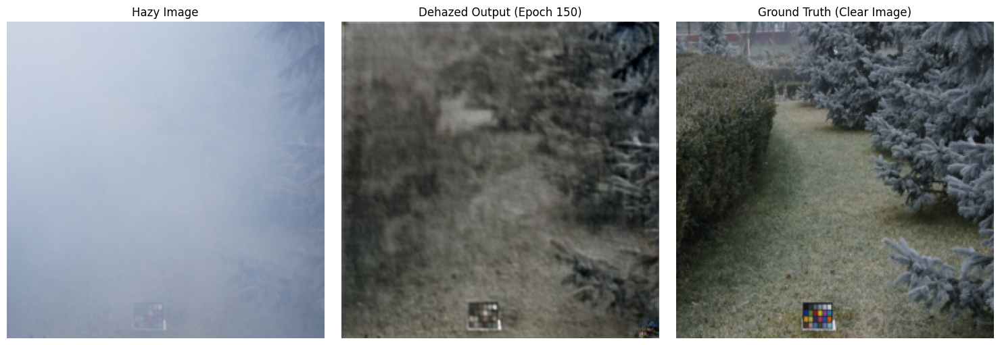

Epoch 151, Loss: 0.0947
Epoch 152, Loss: 0.0934
Epoch 153, Loss: 0.0923
Epoch 154, Loss: 0.0916
Epoch 155, Loss: 0.0904
Epoch 156, Loss: 0.0928
Epoch 157, Loss: 0.0909
Epoch 158, Loss: 0.0912
Epoch 159, Loss: 0.0915
Epoch 160, Loss: 0.0904
Epoch 161, Loss: 0.0902
Epoch 162, Loss: 0.0895
Epoch 163, Loss: 0.0899
Epoch 164, Loss: 0.0910
Epoch 165, Loss: 0.0899
Epoch 166, Loss: 0.0896
Epoch 167, Loss: 0.0914
Epoch 168, Loss: 0.0904
Epoch 169, Loss: 0.0908
Epoch 170, Loss: 0.0895
Epoch 171, Loss: 0.0887
Epoch 172, Loss: 0.0895
Epoch 173, Loss: 0.0888
Epoch 174, Loss: 0.0921
Epoch 175, Loss: 0.0874
Epoch 176, Loss: 0.0905
Epoch 177, Loss: 0.0986
Epoch 178, Loss: 0.1552
Epoch 179, Loss: 0.1324
Epoch 180, Loss: 0.1608
Epoch 181, Loss: 0.1646
Epoch 182, Loss: 0.1609
Epoch 183, Loss: 0.1539
Epoch 184, Loss: 0.1559
Epoch 185, Loss: 0.1498
Epoch 186, Loss: 0.1488
Epoch 187, Loss: 0.1513
Epoch 188, Loss: 0.1351
Epoch 189, Loss: 0.1322
Epoch 190, Loss: 0.1297
Epoch 191, Loss: 0.1240
Epoch 192, Loss:

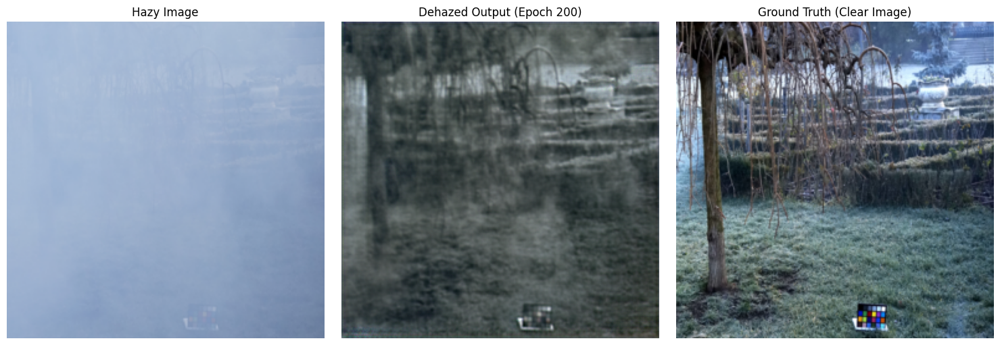

Epoch 201, Loss: 0.1068
Epoch 202, Loss: 0.1063
Epoch 203, Loss: 0.1025
Epoch 204, Loss: 0.0999
Epoch 205, Loss: 0.0996
Epoch 206, Loss: 0.0993
Epoch 207, Loss: 0.0979
Epoch 208, Loss: 0.0986
Epoch 209, Loss: 0.0979
Epoch 210, Loss: 0.0980
Epoch 211, Loss: 0.0963
Epoch 212, Loss: 0.0963
Epoch 213, Loss: 0.0933
Epoch 214, Loss: 0.0928
Epoch 215, Loss: 0.0931
Epoch 216, Loss: 0.0928
Epoch 217, Loss: 0.0917
Epoch 218, Loss: 0.0927
Epoch 219, Loss: 0.0921
Epoch 220, Loss: 0.0901
Epoch 221, Loss: 0.0905
Epoch 222, Loss: 0.0898
Epoch 223, Loss: 0.0909
Epoch 224, Loss: 0.0875
Epoch 225, Loss: 0.0878
Epoch 226, Loss: 0.0897
Epoch 227, Loss: 0.0875
Epoch 228, Loss: 0.0888
Epoch 229, Loss: 0.0870
Epoch 230, Loss: 0.0862
Epoch 231, Loss: 0.0864
Epoch 232, Loss: 0.0870
Epoch 233, Loss: 0.0886
Epoch 234, Loss: 0.0872
Epoch 235, Loss: 0.0866
Epoch 236, Loss: 0.0859
Epoch 237, Loss: 0.0879
Epoch 238, Loss: 0.0871
Epoch 239, Loss: 0.0877
Epoch 240, Loss: 0.0856
Epoch 241, Loss: 0.0858
Epoch 242, Loss:

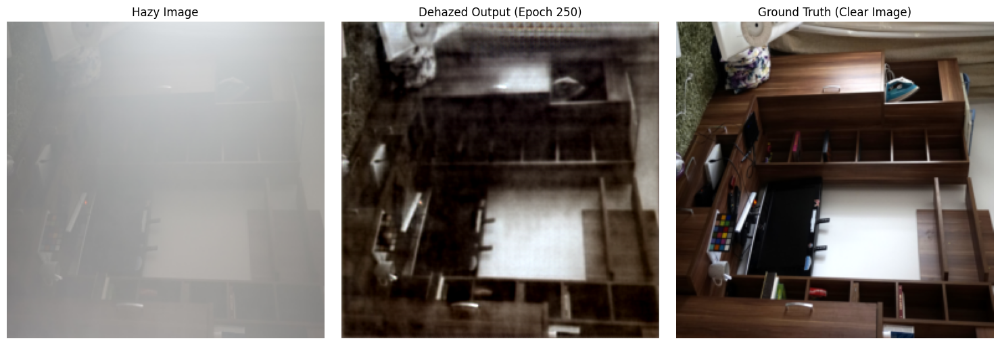

Epoch 251, Loss: 0.0869
Epoch 252, Loss: 0.0884
Epoch 253, Loss: 0.0889
Epoch 254, Loss: 0.0889
Epoch 255, Loss: 0.0887
Epoch 256, Loss: 0.0862
Epoch 257, Loss: 0.0871
Epoch 258, Loss: 0.0842
Epoch 259, Loss: 0.0855
Epoch 260, Loss: 0.0849
Epoch 261, Loss: 0.0841
Epoch 262, Loss: 0.0844
Epoch 263, Loss: 0.0822
Epoch 264, Loss: 0.0832
Epoch 265, Loss: 0.0819
Epoch 266, Loss: 0.0851
Epoch 267, Loss: 0.0817
Epoch 268, Loss: 0.0824
Epoch 269, Loss: 0.0833
Epoch 270, Loss: 0.0815
Epoch 271, Loss: 0.0828
Epoch 272, Loss: 0.0822
Epoch 273, Loss: 0.0805
Epoch 274, Loss: 0.0825
Epoch 275, Loss: 0.0820
Epoch 276, Loss: 0.0830
Epoch 277, Loss: 0.0824
Epoch 278, Loss: 0.0793
Epoch 279, Loss: 0.0792
Epoch 280, Loss: 0.0808
Epoch 281, Loss: 0.0805
Epoch 282, Loss: 0.0816
Epoch 283, Loss: 0.0810
Epoch 284, Loss: 0.0815
Epoch 285, Loss: 0.0813
Epoch 286, Loss: 0.0790
Epoch 287, Loss: 0.0805
Epoch 288, Loss: 0.0806
Epoch 289, Loss: 0.0797
Epoch 290, Loss: 0.0817
Epoch 291, Loss: 0.0783
Epoch 292, Loss:

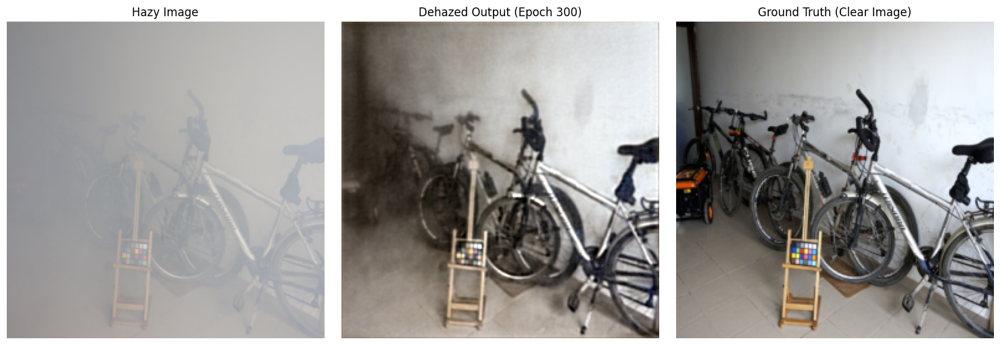

Epoch 301, Loss: 0.0783
Epoch 302, Loss: 0.0787
Epoch 303, Loss: 0.0791
Epoch 304, Loss: 0.0792
Epoch 305, Loss: 0.0779
Epoch 306, Loss: 0.0780
Epoch 307, Loss: 0.0792
Epoch 308, Loss: 0.0782
Epoch 309, Loss: 0.0772
Epoch 310, Loss: 0.0763
Epoch 311, Loss: 0.0801
Epoch 312, Loss: 0.0801
Epoch 313, Loss: 0.0851
Epoch 314, Loss: 0.0894
Epoch 315, Loss: 0.0954
Epoch 316, Loss: 0.0985
Epoch 317, Loss: 0.0933
Epoch 318, Loss: 0.0940
Epoch 319, Loss: 0.0932
Epoch 320, Loss: 0.0945
Epoch 321, Loss: 0.0893
Epoch 322, Loss: 0.0876
Epoch 323, Loss: 0.0869
Epoch 324, Loss: 0.0853
Epoch 325, Loss: 0.0841
Epoch 326, Loss: 0.0826
Epoch 327, Loss: 0.0827
Epoch 328, Loss: 0.0812
Epoch 329, Loss: 0.0813
Epoch 330, Loss: 0.0799
Epoch 331, Loss: 0.0772
Epoch 332, Loss: 0.0768
Epoch 333, Loss: 0.0791
Epoch 334, Loss: 0.0780
Epoch 335, Loss: 0.0774
Epoch 336, Loss: 0.0770
Epoch 337, Loss: 0.0765
Epoch 338, Loss: 0.0762
Epoch 339, Loss: 0.0774
Epoch 340, Loss: 0.0762
Epoch 341, Loss: 0.0766
Epoch 342, Loss:

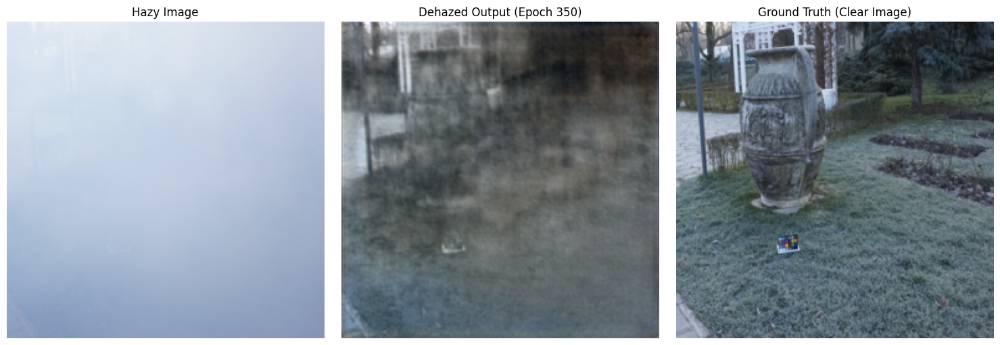

Epoch 351, Loss: 0.0750
Epoch 352, Loss: 0.0759
Epoch 353, Loss: 0.0736
Epoch 354, Loss: 0.0763
Epoch 355, Loss: 0.0752
Epoch 356, Loss: 0.0751
Epoch 357, Loss: 0.0735
Epoch 358, Loss: 0.0743
Epoch 359, Loss: 0.0741
Epoch 360, Loss: 0.0750
Epoch 361, Loss: 0.0736
Epoch 362, Loss: 0.0745
Epoch 363, Loss: 0.0752
Epoch 364, Loss: 0.0773
Epoch 365, Loss: 0.0754
Epoch 366, Loss: 0.0750
Epoch 367, Loss: 0.0773
Epoch 368, Loss: 0.0751
Epoch 369, Loss: 0.0783
Epoch 370, Loss: 0.0772
Epoch 371, Loss: 0.0739
Epoch 372, Loss: 0.0762
Epoch 373, Loss: 0.0753
Epoch 374, Loss: 0.0746
Epoch 375, Loss: 0.0729
Epoch 376, Loss: 0.0749
Epoch 377, Loss: 0.0745
Epoch 378, Loss: 0.0727
Epoch 379, Loss: 0.0736
Epoch 380, Loss: 0.0735
Epoch 381, Loss: 0.0741
Epoch 382, Loss: 0.0718
Epoch 383, Loss: 0.0737
Epoch 384, Loss: 0.0727
Epoch 385, Loss: 0.0747
Epoch 386, Loss: 0.0726
Epoch 387, Loss: 0.0730
Epoch 388, Loss: 0.0737
Epoch 389, Loss: 0.0726
Epoch 390, Loss: 0.0720
Epoch 391, Loss: 0.0714
Epoch 392, Loss:

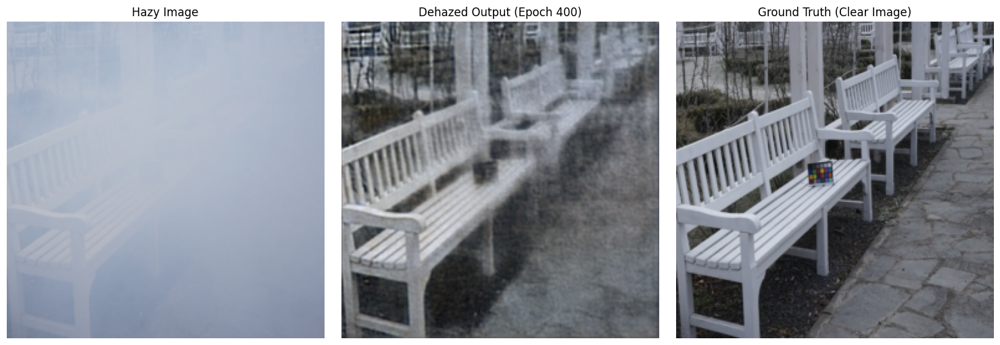

Epoch 401, Loss: 0.0718
Epoch 402, Loss: 0.0711
Epoch 403, Loss: 0.0714
Epoch 404, Loss: 0.0706
Epoch 405, Loss: 0.0716
Epoch 406, Loss: 0.0713
Epoch 407, Loss: 0.0694
Epoch 408, Loss: 0.0714
Epoch 409, Loss: 0.0712
Epoch 410, Loss: 0.0705
Epoch 411, Loss: 0.0738
Epoch 412, Loss: 0.0698
Epoch 413, Loss: 0.0703
Epoch 414, Loss: 0.0720
Epoch 415, Loss: 0.0718
Epoch 416, Loss: 0.0710
Epoch 417, Loss: 0.0716
Epoch 418, Loss: 0.0740
Epoch 419, Loss: 0.0723
Epoch 420, Loss: 0.0715
Epoch 421, Loss: 0.0737
Epoch 422, Loss: 0.0739
Epoch 423, Loss: 0.0725
Epoch 424, Loss: 0.0713
Epoch 425, Loss: 0.0768
Epoch 426, Loss: 0.0789
Epoch 427, Loss: 0.0885
Epoch 428, Loss: 0.0966
Epoch 429, Loss: 0.0880
Epoch 430, Loss: 0.0928
Epoch 431, Loss: 0.0894
Epoch 432, Loss: 0.0870
Epoch 433, Loss: 0.0847
Epoch 434, Loss: 0.0830
Epoch 435, Loss: 0.0832
Epoch 436, Loss: 0.0823
Epoch 437, Loss: 0.0772
Epoch 438, Loss: 0.0794
Epoch 439, Loss: 0.0784
Epoch 440, Loss: 0.0749
Epoch 441, Loss: 0.0756
Epoch 442, Loss:

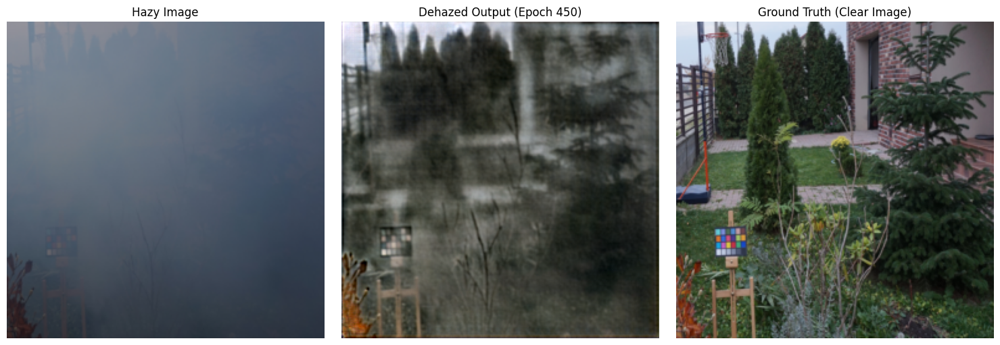

Epoch 451, Loss: 0.0715
Epoch 452, Loss: 0.0734
Epoch 453, Loss: 0.0714
Epoch 454, Loss: 0.0700
Epoch 455, Loss: 0.0728
Epoch 456, Loss: 0.0736
Epoch 457, Loss: 0.0734
Epoch 458, Loss: 0.0720
Epoch 459, Loss: 0.0736
Epoch 460, Loss: 0.0712
Epoch 461, Loss: 0.0734
Epoch 462, Loss: 0.0700
Epoch 463, Loss: 0.0740
Epoch 464, Loss: 0.0714
Epoch 465, Loss: 0.0711
Epoch 466, Loss: 0.0723
Epoch 467, Loss: 0.0718
Epoch 468, Loss: 0.0699
Epoch 469, Loss: 0.0697
Epoch 470, Loss: 0.0704
Epoch 471, Loss: 0.0692
Epoch 472, Loss: 0.0706
Epoch 473, Loss: 0.0697
Epoch 474, Loss: 0.0686
Epoch 475, Loss: 0.0687
Epoch 476, Loss: 0.0676
Epoch 477, Loss: 0.0695
Epoch 478, Loss: 0.0677
Epoch 479, Loss: 0.0673
Epoch 480, Loss: 0.0676
Epoch 481, Loss: 0.0682
Epoch 482, Loss: 0.0680
Epoch 483, Loss: 0.0690
Epoch 484, Loss: 0.0677
Epoch 485, Loss: 0.0677
Epoch 486, Loss: 0.0679
Epoch 487, Loss: 0.0688
Epoch 488, Loss: 0.0664
Epoch 489, Loss: 0.0685
Epoch 490, Loss: 0.0676
Epoch 491, Loss: 0.0685
Epoch 492, Loss:

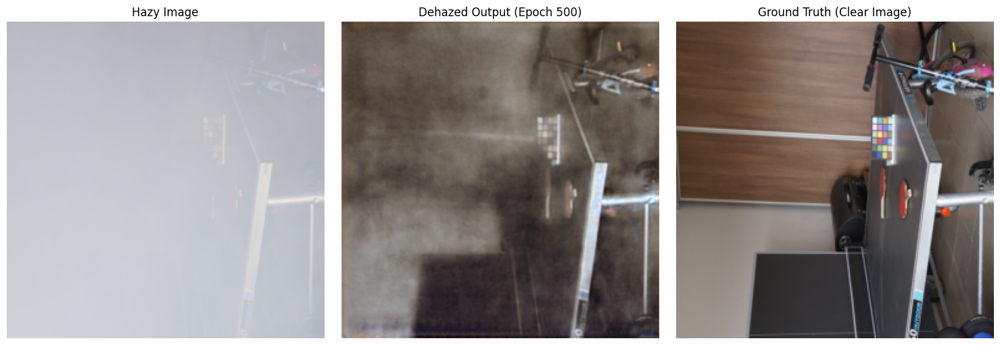

Epoch 501, Loss: 0.0767
Epoch 502, Loss: 0.0757
Epoch 503, Loss: 0.0738
Epoch 504, Loss: 0.0738
Epoch 505, Loss: 0.0719
Epoch 506, Loss: 0.0718
Epoch 507, Loss: 0.0690
Epoch 508, Loss: 0.0697
Epoch 509, Loss: 0.0701
Epoch 510, Loss: 0.0683
Epoch 511, Loss: 0.0696
Epoch 512, Loss: 0.0673
Epoch 513, Loss: 0.0675
Epoch 514, Loss: 0.0672
Epoch 515, Loss: 0.0670
Epoch 516, Loss: 0.0680
Epoch 517, Loss: 0.0681
Epoch 518, Loss: 0.0669
Epoch 519, Loss: 0.0667
Epoch 520, Loss: 0.0677
Epoch 521, Loss: 0.0678
Epoch 522, Loss: 0.0685
Epoch 523, Loss: 0.0685
Epoch 524, Loss: 0.0690
Epoch 525, Loss: 0.0692
Epoch 526, Loss: 0.0691
Epoch 527, Loss: 0.0686
Epoch 528, Loss: 0.0675
Epoch 529, Loss: 0.0685
Epoch 530, Loss: 0.0677
Epoch 531, Loss: 0.0684
Epoch 532, Loss: 0.0694
Epoch 533, Loss: 0.0675
Epoch 534, Loss: 0.0660
Epoch 535, Loss: 0.0668
Epoch 536, Loss: 0.0670
Epoch 537, Loss: 0.0657
Epoch 538, Loss: 0.0667
Epoch 539, Loss: 0.0655
Epoch 540, Loss: 0.0688
Epoch 541, Loss: 0.0682
Epoch 542, Loss:

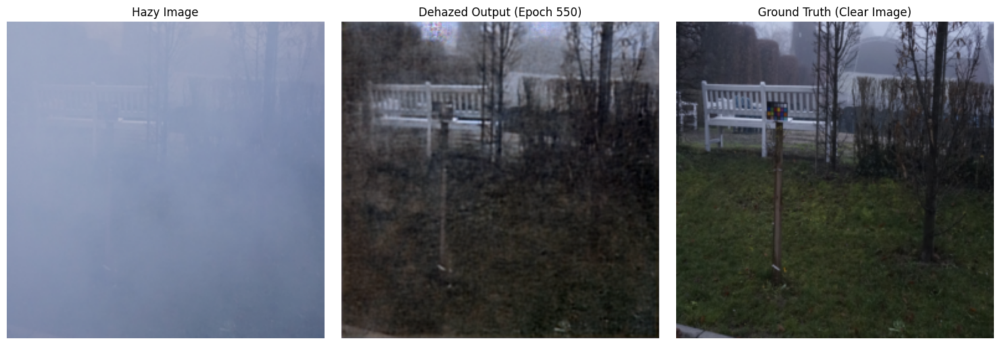

Epoch 551, Loss: 0.0653
Epoch 552, Loss: 0.0652
Epoch 553, Loss: 0.0654
Epoch 554, Loss: 0.0651
Epoch 555, Loss: 0.0642
Epoch 556, Loss: 0.0648
Epoch 557, Loss: 0.0651
Epoch 558, Loss: 0.0656
Epoch 559, Loss: 0.0641
Epoch 560, Loss: 0.0651
Epoch 561, Loss: 0.0647
Epoch 562, Loss: 0.0648
Epoch 563, Loss: 0.0664
Epoch 564, Loss: 0.0636
Epoch 565, Loss: 0.0654
Epoch 566, Loss: 0.0657
Epoch 567, Loss: 0.0669
Epoch 568, Loss: 0.0682
Epoch 569, Loss: 0.0683
Epoch 570, Loss: 0.0669
Epoch 571, Loss: 0.0681
Epoch 572, Loss: 0.0676
Epoch 573, Loss: 0.0670
Epoch 574, Loss: 0.0677
Epoch 575, Loss: 0.0674
Epoch 576, Loss: 0.0669
Epoch 577, Loss: 0.0667
Epoch 578, Loss: 0.0662
Epoch 579, Loss: 0.0695
Epoch 580, Loss: 0.0682
Epoch 581, Loss: 0.0682
Epoch 582, Loss: 0.0689
Epoch 583, Loss: 0.0682
Epoch 584, Loss: 0.0683
Epoch 585, Loss: 0.0668
Epoch 586, Loss: 0.0676
Epoch 587, Loss: 0.0661
Epoch 588, Loss: 0.0657
Epoch 589, Loss: 0.0658
Epoch 590, Loss: 0.0645
Epoch 591, Loss: 0.0656
Epoch 592, Loss:

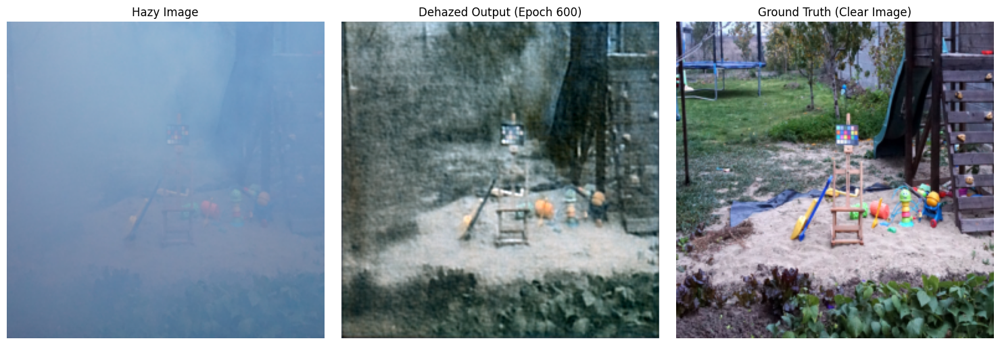

Epoch 601, Loss: 0.0665
Epoch 602, Loss: 0.0651
Epoch 603, Loss: 0.0657
Epoch 604, Loss: 0.0666
Epoch 605, Loss: 0.0651
Epoch 606, Loss: 0.0654
Epoch 607, Loss: 0.0652
Epoch 608, Loss: 0.0646
Epoch 609, Loss: 0.0646
Epoch 610, Loss: 0.0639
Epoch 611, Loss: 0.0627
Epoch 612, Loss: 0.0633
Epoch 613, Loss: 0.0638
Epoch 614, Loss: 0.0664
Epoch 615, Loss: 0.0636
Epoch 616, Loss: 0.0631
Epoch 617, Loss: 0.0652
Epoch 618, Loss: 0.0644
Epoch 619, Loss: 0.0644
Epoch 620, Loss: 0.0628
Epoch 621, Loss: 0.0619
Epoch 622, Loss: 0.0642
Epoch 623, Loss: 0.0628
Epoch 624, Loss: 0.0638
Epoch 625, Loss: 0.0639
Epoch 626, Loss: 0.0634
Epoch 627, Loss: 0.0638
Epoch 628, Loss: 0.0645
Epoch 629, Loss: 0.0634
Epoch 630, Loss: 0.0636
Epoch 631, Loss: 0.0630
Epoch 632, Loss: 0.0633
Epoch 633, Loss: 0.0640
Epoch 634, Loss: 0.0631
Epoch 635, Loss: 0.0641
Epoch 636, Loss: 0.0647
Epoch 637, Loss: 0.0624
Epoch 638, Loss: 0.0643
Epoch 639, Loss: 0.0641
Epoch 640, Loss: 0.0645
Epoch 641, Loss: 0.0638
Epoch 642, Loss:

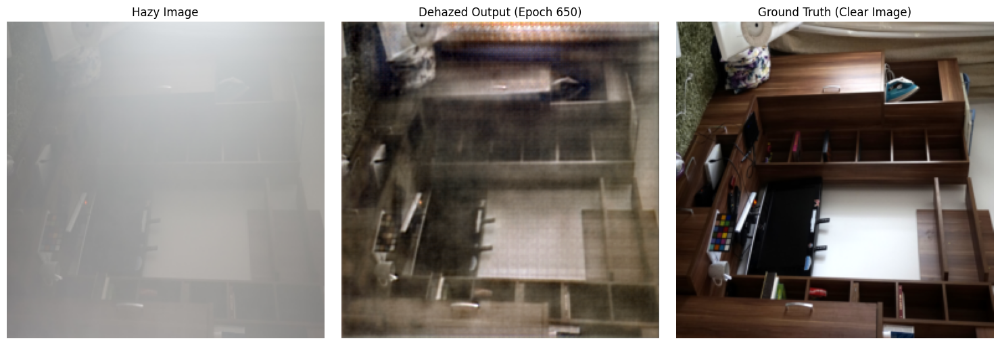

Epoch 651, Loss: 0.1486
Epoch 652, Loss: 0.1402
Epoch 653, Loss: 0.1279
Epoch 654, Loss: 0.1186
Epoch 655, Loss: 0.1181
Epoch 656, Loss: 0.1220
Epoch 657, Loss: 0.1210
Epoch 658, Loss: 0.1179
Epoch 659, Loss: 0.1099
Epoch 660, Loss: 0.1027
Epoch 661, Loss: 0.0960
Epoch 662, Loss: 0.0928
Epoch 663, Loss: 0.0904
Epoch 664, Loss: 0.0863
Epoch 665, Loss: 0.0875
Epoch 666, Loss: 0.0836
Epoch 667, Loss: 0.0825
Epoch 668, Loss: 0.0806
Epoch 669, Loss: 0.0798
Epoch 670, Loss: 0.0782
Epoch 671, Loss: 0.0790
Epoch 672, Loss: 0.0787
Epoch 673, Loss: 0.0767
Epoch 674, Loss: 0.0759
Epoch 675, Loss: 0.0749
Epoch 676, Loss: 0.0763
Epoch 677, Loss: 0.0737
Epoch 678, Loss: 0.0744
Epoch 679, Loss: 0.0733
Epoch 680, Loss: 0.0745
Epoch 681, Loss: 0.0743
Epoch 682, Loss: 0.0741
Epoch 683, Loss: 0.0741
Epoch 684, Loss: 0.0763
Epoch 685, Loss: 0.0739
Epoch 686, Loss: 0.0760
Epoch 687, Loss: 0.0726
Epoch 688, Loss: 0.0728
Epoch 689, Loss: 0.0737
Epoch 690, Loss: 0.0710
Epoch 691, Loss: 0.0734
Epoch 692, Loss:

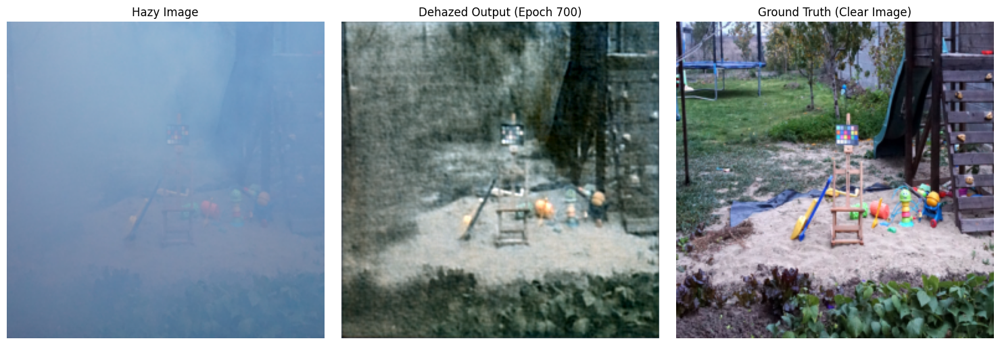

Epoch 701, Loss: 0.0693
Epoch 702, Loss: 0.0668
Epoch 703, Loss: 0.0699
Epoch 704, Loss: 0.0675
Epoch 705, Loss: 0.0679
Epoch 706, Loss: 0.0695
Epoch 707, Loss: 0.0667
Epoch 708, Loss: 0.0682
Epoch 709, Loss: 0.0674
Epoch 710, Loss: 0.0673
Epoch 711, Loss: 0.0657
Epoch 712, Loss: 0.0676
Epoch 713, Loss: 0.0648
Epoch 714, Loss: 0.0673
Epoch 715, Loss: 0.0673
Epoch 716, Loss: 0.0655
Epoch 717, Loss: 0.0650
Epoch 718, Loss: 0.0660
Epoch 719, Loss: 0.0647
Epoch 720, Loss: 0.0655
Epoch 721, Loss: 0.0675
Epoch 722, Loss: 0.0687
Epoch 723, Loss: 0.0685
Epoch 724, Loss: 0.0693
Epoch 725, Loss: 0.0667
Epoch 726, Loss: 0.0684
Epoch 727, Loss: 0.0670
Epoch 728, Loss: 0.0674
Epoch 729, Loss: 0.0664
Epoch 730, Loss: 0.0662
Epoch 731, Loss: 0.0649
Epoch 732, Loss: 0.0667
Epoch 733, Loss: 0.0651
Epoch 734, Loss: 0.0663
Epoch 735, Loss: 0.0649
Epoch 736, Loss: 0.0651
Epoch 737, Loss: 0.0667
Epoch 738, Loss: 0.0637
Epoch 739, Loss: 0.0647
Epoch 740, Loss: 0.0637
Epoch 741, Loss: 0.0633
Epoch 742, Loss:

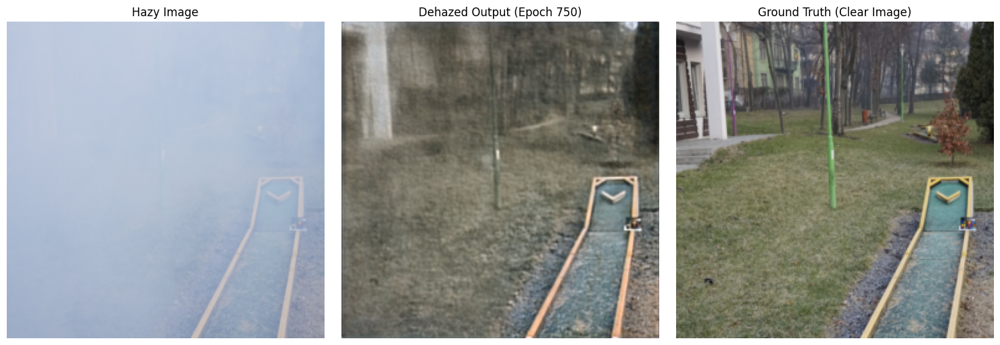

Epoch 751, Loss: 0.0636
Epoch 752, Loss: 0.0632
Epoch 753, Loss: 0.0621
Epoch 754, Loss: 0.0627
Epoch 755, Loss: 0.0632
Epoch 756, Loss: 0.0628
Epoch 757, Loss: 0.0626
Epoch 758, Loss: 0.0636
Epoch 759, Loss: 0.0633
Epoch 760, Loss: 0.0626
Epoch 761, Loss: 0.0624
Epoch 762, Loss: 0.0628
Epoch 763, Loss: 0.0628
Epoch 764, Loss: 0.0634
Epoch 765, Loss: 0.0632
Epoch 766, Loss: 0.0631
Epoch 767, Loss: 0.0660
Epoch 768, Loss: 0.0722
Epoch 769, Loss: 0.0743
Epoch 770, Loss: 0.0726
Epoch 771, Loss: 0.0709
Epoch 772, Loss: 0.0690
Epoch 773, Loss: 0.0685
Epoch 774, Loss: 0.0653
Epoch 775, Loss: 0.0660
Epoch 776, Loss: 0.0663
Epoch 777, Loss: 0.0653
Epoch 778, Loss: 0.0654
Epoch 779, Loss: 0.0655
Epoch 780, Loss: 0.0653
Epoch 781, Loss: 0.0645
Epoch 782, Loss: 0.0640
Epoch 783, Loss: 0.0632
Epoch 784, Loss: 0.0633
Epoch 785, Loss: 0.0641
Epoch 786, Loss: 0.0619
Epoch 787, Loss: 0.0633
Epoch 788, Loss: 0.0634
Epoch 789, Loss: 0.0628
Epoch 790, Loss: 0.0636
Epoch 791, Loss: 0.0638
Epoch 792, Loss:

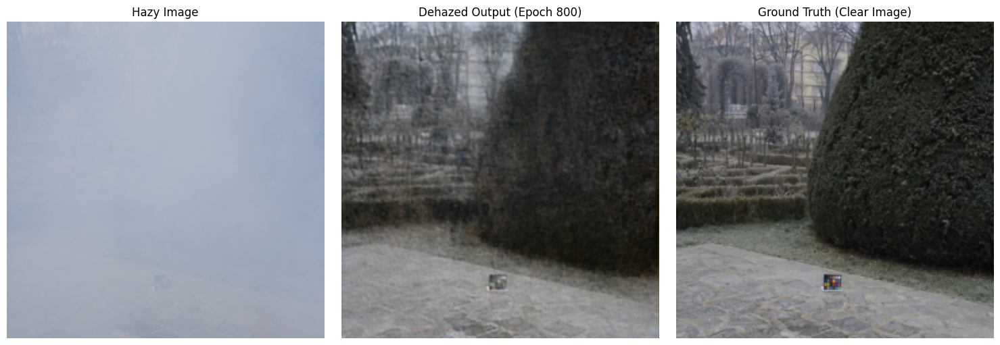

Epoch 801, Loss: 0.0622
Epoch 802, Loss: 0.0621
Epoch 803, Loss: 0.0623
Epoch 804, Loss: 0.0637
Epoch 805, Loss: 0.0635
Epoch 806, Loss: 0.0642
Epoch 807, Loss: 0.0613
Epoch 808, Loss: 0.0626
Epoch 809, Loss: 0.0617
Epoch 810, Loss: 0.0624
Epoch 811, Loss: 0.0614
Epoch 812, Loss: 0.0626
Epoch 813, Loss: 0.0604
Epoch 814, Loss: 0.0612
Epoch 815, Loss: 0.0615
Epoch 816, Loss: 0.0621
Epoch 817, Loss: 0.0608
Epoch 818, Loss: 0.0608
Epoch 819, Loss: 0.0621
Epoch 820, Loss: 0.0625
Epoch 821, Loss: 0.0607
Epoch 822, Loss: 0.0617
Epoch 823, Loss: 0.0613
Epoch 824, Loss: 0.0604
Epoch 825, Loss: 0.0600
Epoch 826, Loss: 0.0609
Epoch 827, Loss: 0.0612
Epoch 828, Loss: 0.0604
Epoch 829, Loss: 0.0602
Epoch 830, Loss: 0.0605
Epoch 831, Loss: 0.0586
Epoch 832, Loss: 0.0597
Epoch 833, Loss: 0.0597
Epoch 834, Loss: 0.0602
Epoch 835, Loss: 0.0598
Epoch 836, Loss: 0.0598
Epoch 837, Loss: 0.0608
Epoch 838, Loss: 0.0598
Epoch 839, Loss: 0.0581
Epoch 840, Loss: 0.0602
Epoch 841, Loss: 0.0609
Epoch 842, Loss:

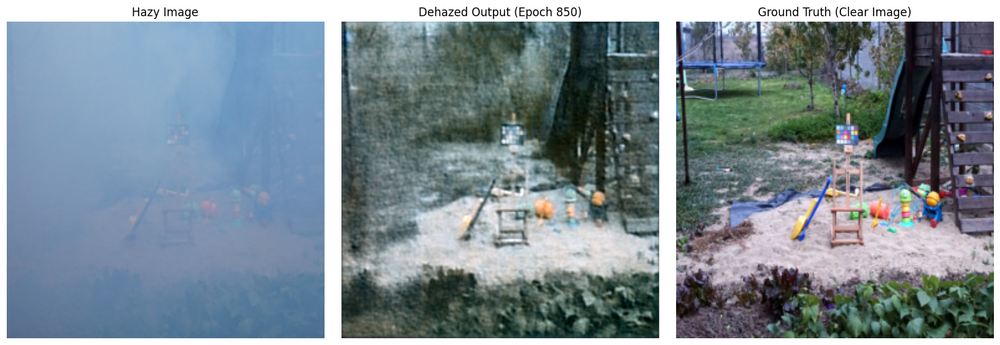

Epoch 851, Loss: 0.0594
Epoch 852, Loss: 0.0609
Epoch 853, Loss: 0.0598
Epoch 854, Loss: 0.0601
Epoch 855, Loss: 0.0620
Epoch 856, Loss: 0.0618
Epoch 857, Loss: 0.0598
Epoch 858, Loss: 0.0617
Epoch 859, Loss: 0.0609
Epoch 860, Loss: 0.0625
Epoch 861, Loss: 0.0616
Epoch 862, Loss: 0.0611
Epoch 863, Loss: 0.0615
Epoch 864, Loss: 0.0608
Epoch 865, Loss: 0.0611
Epoch 866, Loss: 0.0604
Epoch 867, Loss: 0.0607
Epoch 868, Loss: 0.0612
Epoch 869, Loss: 0.0627
Epoch 870, Loss: 0.0633
Epoch 871, Loss: 0.0627
Epoch 872, Loss: 0.0635
Epoch 873, Loss: 0.0626
Epoch 874, Loss: 0.0614
Epoch 875, Loss: 0.0616
Epoch 876, Loss: 0.0619
Epoch 877, Loss: 0.0617
Epoch 878, Loss: 0.0606
Epoch 879, Loss: 0.0626
Epoch 880, Loss: 0.0609
Epoch 881, Loss: 0.0613
Epoch 882, Loss: 0.0606
Epoch 883, Loss: 0.0620
Epoch 884, Loss: 0.0615
Epoch 885, Loss: 0.0605
Epoch 886, Loss: 0.0605
Epoch 887, Loss: 0.0609
Epoch 888, Loss: 0.0602
Epoch 889, Loss: 0.0591
Epoch 890, Loss: 0.0601
Epoch 891, Loss: 0.0605
Epoch 892, Loss:

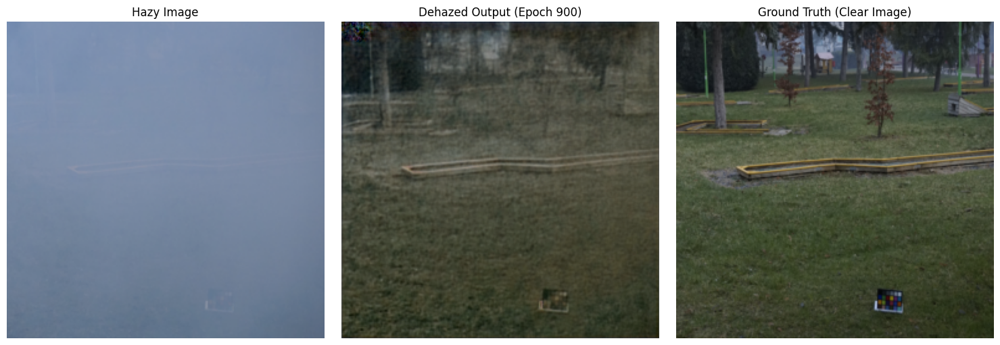

Epoch 901, Loss: 0.0582
Epoch 902, Loss: 0.0585
Epoch 903, Loss: 0.0601
Epoch 904, Loss: 0.0590
Epoch 905, Loss: 0.0592
Epoch 906, Loss: 0.0595
Epoch 907, Loss: 0.0588
Epoch 908, Loss: 0.0599
Epoch 909, Loss: 0.0623
Epoch 910, Loss: 0.0612
Epoch 911, Loss: 0.0597
Epoch 912, Loss: 0.0631
Epoch 913, Loss: 0.0618
Epoch 914, Loss: 0.0634
Epoch 915, Loss: 0.0627
Epoch 916, Loss: 0.0631
Epoch 917, Loss: 0.0617
Epoch 918, Loss: 0.0612
Epoch 919, Loss: 0.0599
Epoch 920, Loss: 0.0601
Epoch 921, Loss: 0.0599
Epoch 922, Loss: 0.0603
Epoch 923, Loss: 0.0598
Epoch 924, Loss: 0.0594
Epoch 925, Loss: 0.0618
Epoch 926, Loss: 0.0625
Epoch 927, Loss: 0.0612
Epoch 928, Loss: 0.0622
Epoch 929, Loss: 0.0597
Epoch 930, Loss: 0.0614
Epoch 931, Loss: 0.0598
Epoch 932, Loss: 0.0596
Epoch 933, Loss: 0.0589
Epoch 934, Loss: 0.0593
Epoch 935, Loss: 0.0593
Epoch 936, Loss: 0.0590
Epoch 937, Loss: 0.0577
Epoch 938, Loss: 0.0571
Epoch 939, Loss: 0.0577
Epoch 940, Loss: 0.0642
Epoch 941, Loss: 0.0857
Epoch 942, Loss:

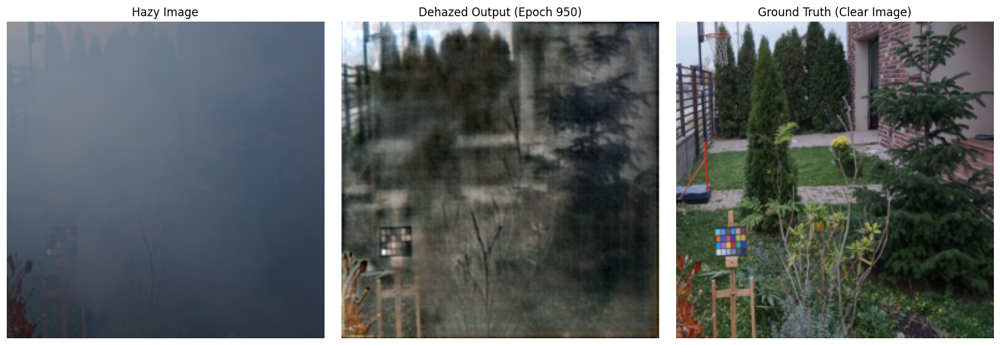

Epoch 951, Loss: 0.0919
Epoch 952, Loss: 0.0862
Epoch 953, Loss: 0.0823
Epoch 954, Loss: 0.0808
Epoch 955, Loss: 0.0764
Epoch 956, Loss: 0.0771
Epoch 957, Loss: 0.0745
Epoch 958, Loss: 0.0734
Epoch 959, Loss: 0.0724
Epoch 960, Loss: 0.0710
Epoch 961, Loss: 0.0702
Epoch 962, Loss: 0.0709
Epoch 963, Loss: 0.0692
Epoch 964, Loss: 0.0671
Epoch 965, Loss: 0.0680
Epoch 966, Loss: 0.0657
Epoch 967, Loss: 0.0655
Epoch 968, Loss: 0.0651
Epoch 969, Loss: 0.0661
Epoch 970, Loss: 0.0666
Epoch 971, Loss: 0.0649
Epoch 972, Loss: 0.0630
Epoch 973, Loss: 0.0641
Epoch 974, Loss: 0.0620
Epoch 975, Loss: 0.0624
Epoch 976, Loss: 0.0627
Epoch 977, Loss: 0.0631
Epoch 978, Loss: 0.0623
Epoch 979, Loss: 0.0621
Epoch 980, Loss: 0.0622
Epoch 981, Loss: 0.0616
Epoch 982, Loss: 0.0612
Epoch 983, Loss: 0.0616
Epoch 984, Loss: 0.0625
Epoch 985, Loss: 0.0616
Epoch 986, Loss: 0.0634
Epoch 987, Loss: 0.0612
Epoch 988, Loss: 0.0636
Epoch 989, Loss: 0.0614
Epoch 990, Loss: 0.0614
Epoch 991, Loss: 0.0619
Epoch 992, Loss:

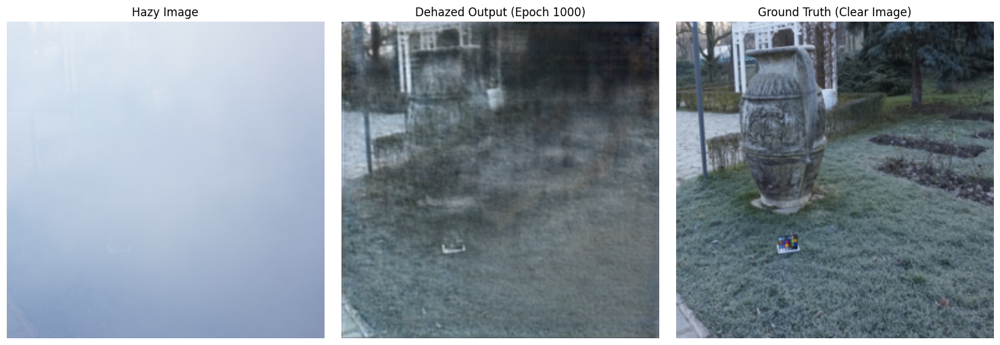

In [ ]:
import matplotlib.pyplot as plt
from torch.cuda.amp import GradScaler, autocast

scaler = GradScaler()  # Mixed precision scaler

def denormalize(img):
    """Denormalize the image if it was normalized during training."""
    return img * 0.5 + 0.5  # Assuming normalization with mean=0.5, std=0.5
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = NAFNet(img_channel=3, width=16, middle_blk_num=1, enc_blk_nums=[1, 1, 1], dec_blk_nums=[1, 1, 1]).to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
for epoch in range(1000):  # 1000 epochs
    model.train()
    total_loss = 0

    for hazy, clear in train_loader:
        hazy, clear = hazy.to(device), clear.to(device)

        optimizer.zero_grad()
        with autocast():  # Enable mixed precision
            output = model(hazy)
            loss = combined_loss(output, clear)

        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        total_loss += loss.item()

    # Print average loss for this epoch
    print(f"Epoch {epoch+1}, Loss: {total_loss / len(train_loader):.4f}")

    # Visualize outputs every 50 epochs
    if (epoch + 1) % 50 == 0:
        model.eval()
        with torch.no_grad():
            hazy_vis, clear_vis = next(iter(train_loader))  # Fetch one batch for visualization
            hazy_vis, clear_vis = hazy_vis.to(device), clear_vis.to(device)
            output_vis = model(hazy_vis)

        # Prepare images for visualization
        hazy_img = denormalize(hazy_vis[0].cpu().permute(1, 2, 0)).numpy().clip(0, 1)
        output_img = denormalize(output_vis[0].cpu().permute(1, 2, 0)).numpy().clip(0, 1)
        clear_img = denormalize(clear_vis[0].cpu().permute(1, 2, 0)).numpy().clip(0, 1)

        # Plot the images side by side
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(hazy_img)
        axes[0].set_title("Hazy Image")
        axes[0].axis("off")

        axes[1].imshow(output_img)
        axes[1].set_title(f"Dehazed Output (Epoch {epoch+1})")
        axes[1].axis("off")

        axes[2].imshow(clear_img)
        axes[2].set_title("Ground Truth (Clear Image)")
        axes[2].axis("off")

        plt.tight_layout()
        plt.show()

        model.train()  # Switch back to training mode


**Visualization**

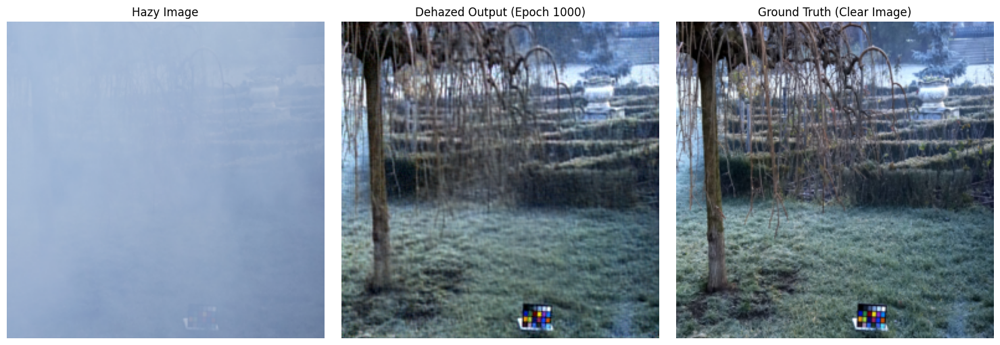

In [ ]:

model.eval()
with torch.no_grad():
    hazy, clear = next(iter(single_loader))
    hazy, clear = hazy.to(device), clear.to(device)
    output = model(hazy)  # Get the dehazed output

# Prepare images for visualization
hazy_img = hazy[0].cpu().permute(1, 2, 0).numpy().clip(0, 1)
output_img = output[0].cpu().permute(1, 2, 0).numpy().clip(0, 1)
clear_img = clear[0].cpu().permute(1, 2, 0).numpy().clip(0, 1)

# Plot the images side by side
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Hazy Image
axes[0].imshow(hazy_img)
axes[0].set_title("Hazy Image")
axes[0].axis("off")

# Dehazed Output (Epoch 1000)
axes[1].imshow(output_img)
axes[1].set_title("Dehazed Output (Epoch 1000)")
axes[1].axis("off")

# Ground Truth
axes[2].imshow(clear_img)
axes[2].set_title("Ground Truth (Clear Image)")
axes[2].axis("off")

plt.tight_layout()
plt.show()
